# Simulations with well-constrained synaptic input

Here, we place a cell in barrel cortex and compute an anatomical realization, which specifies, where synapses are located. Afterwards, we activate the synapses based on experimental measurements. Next, we import the simulation result to analyze it. Whenever necessary, dask and distributed is used to parallelize the computation.

In [3]:
import Interface as I
from getting_started import getting_started_dir
import os
db = I.DataBase('{}/labs/getting_started_db/'.format(os.environ['HOME']))

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!


## Step 1: Registering the cell morphology in the barrel cortex reference frame

From external resources (e.g. the NeuroMorph pipeline), you need a hoc-file with the dendrite morphology you want to place in the barrel cortex model. The coordinates in the hoc morphology file need to be anchored at the desired location in the barrel cortex

There is a morphology file in the getting_started/anatomical_constraints subfolder, which is registered such that the cell is in the center of the C2 column. For the following steps, this morphology is used:

In [4]:
I.os.listdir(I.os.path.join(getting_started_dir, 'anatomical_constraints'))

['86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.hoc',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.swc',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_scaled_diameters.hoc']

For building the anatomical model, we use '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.hoc', for the simulation of the evoked activity, we need to use the morphology file with scaled apical trunk. Why the scaling is necessary is described [above](#WhyWeNeedScaling).

In [5]:
path_to_hoc = I.os.path.join(getting_started_dir, 'anatomical_constraints', \
                    '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.hoc')
path_to_scaled_hoc = I.os.path.join(getting_started_dir, 'anatomical_constraints', \
                    '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_scaled_diameters.hoc')

We copy both files to our DataBase. 

In [6]:
#db = I.DataBase('/home/abast/my_db/')

if not 'anatomical_constraints' in db.keys():
    db.create_managed_folder('anatomical_constraints')
    I.shutil.copy(path_to_hoc, db['anatomical_constraints'])
    I.shutil.copy(path_to_scaled_hoc, db['anatomical_constraints'])

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!


**Sidenote:** The copying step is optional if we just want to run the simulation. To make the database self-containing (i.e. after copying it to another machine to an arbitrary path, all paths in all parameter files are stil valid and simulations can be rerun immediately), it is required that all files are in a ModelDataBase: In this case, we could use the following path to refer to the hoc file:
`mdb://2017-10-19_3728_uOGyyhY/anatomical_constraints/some_file.hoc`*

In [7]:
db.get_id()

'2024-01-18_138386_weSxIMf'

In [8]:
import psutil
print(psutil.__version__)
n_cpus = psutil.cpu_count(logical=True)
print(n_cpus)

5.7.2
48


## Step 2: calculate positions of anatomical synapses with respect to the registered morphology

We use the singlecell_input_mapper to create an anatomical model of how that cell is integrated in barrel cortex. The following code calculates the position of synapses onto the example cell. Under the hood, 50 anatomical realizations will be computed. Out of these, the one that is closest to the average is choosen, which then can be refered to as a "representative realization". The result is saved in the same folder as the hoc morphology. This takes about 4 hrs to compute, but you can continue with a precomputed result.

In [9]:
# Computing it yourself: --------------------
# celltype = 'L5tt'
# path = db['anatomical_constraints'].join('86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.hoc')
# with I.silence_stdout:
#     I.map_singlecell_inputs(path, celltype) # this takes some time
# # adapt the path, if you have generated a new anatomical model
# path_to_anatomical_model = db['anatomical_constraints'].join('86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389')

# Pre-computed result: --------------------
from distutils.dir_util import copy_tree
dirname = '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389'
path_to_anatomical_model = I.os.path.join(getting_started_dir, 'anatomical_constraints', dirname, dirname)
silent = copy_tree(path_to_anatomical_model, db['anatomical_constraints'])

**What does the result of the map_singlecell_inputs script look like?**

In the directory generated by the singlecell_input_mapper, there are the following files:

In [10]:
db['anatomical_constraints'].listdir()

['86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389.syn',
 'presynaptic_somata.sh~',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_summary_20150504-1611_10389.csv',
 'total_synapses',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.hoc',
 'presynaptic_somata',
 'NumberOfConnectedCells.csv',
 'apical_synapses',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389.con',
 '86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_scaled_diameters.hoc',
 'presynaptic_somata.sh',
 'soma_synapses',
 'basal_synapses']

- The most important files are the *.con file and the *.syn. These files are the relevant output of the SingleCellMapper for simulations of evoked activity.

- The  *_summary_*.csv file contains summary statistics about the connectivity between all presynaptic populations and our neuron.

The con file maps between presynaptic cells and synapses:

In [11]:
con_file = db['anatomical_constraints'].get_file('.con')
con_file_path = db['anatomical_constraints'].join(con_file)
con_file_path

'/gpfs/soma_fs/home/meulemeester/labs/getting_started_db/anatomical_constraints/86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389.con'

In [12]:
with open(con_file_path) as f:
    print(f.read()[:300])

# Anatomical connectivity realization file; only valid with synapse realization:
# 86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_synapses_20150504-1611_10389.syn
# Type - cell ID - synapse ID

L6cc_A3	0	0
L6cc_A3	1	1
L6cc_A3	2	2
L6cc_A3	3	3
L6cc_A3	4	4
L6cc_A3	4	5
L6cc_A3	5	6


The .syn file specifies the exact position of each synapse on the hoc morphology:

In [13]:
syn_file_path = db['anatomical_constraints'].join(db['anatomical_constraints'].get_file('.syn'))
with open(syn_file_path) as f:
    print(f.read()[:300])

# Synapse distribution file
# corresponding to cell: 86_L5_86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center
# Type - section - section.x

VPM_E1	112	0.138046479525
VPM_E1	130	0.305058053119
VPM_E1	130	0.190509288017
VPM_E1	9	0.368760777084
VPM_E1	110	0.0
VPM_E1	11	0.120662910562


Here, section referes to the ID od the section in the cell object. x specifies, where along that section the synapse is placed. If x is 0, this is the beginning of the section, if x is one, this is the end of the section.

The subfolders in the directory contain Amira landmark files:
 - for the location of presynaptic_somata by celltype in the folder `presynaptic_somata`
 - for the location of synapses in the folders `total_synapses`, `soma_synapses`, `basal_synapses`, `apical_synapses`

### How to parallelize the generation of anatomical models?

We can use a distributed Client to create our `.syn` and `.con` files for one morphology per process:

In [14]:
client = I.get_client(timeout=10)

getting client with ip 10.102.2.82
got client <Client: 'tcp://10.102.2.82:38786' processes=24 threads=24, memory=98.30 GB>


In [15]:
import psutil
print(psutil.cpu_count(logical=True))

48


In [16]:
morphology_paths = [db['anatomical_constraints'].join(f) for f in db['anatomical_constraints'].listdir() if f.endswith('.hoc')]
morphology_paths

['/gpfs/soma_fs/home/meulemeester/labs/getting_started_db/anatomical_constraints/86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center.hoc',
 '/gpfs/soma_fs/home/meulemeester/labs/getting_started_db/anatomical_constraints/86_L5_CDK20041214_nr3L5B_dend_PC_neuron_transform_registered_C2center_scaled_diameters.hoc']

In [15]:
delayed_map_singlecell_inputs = I.dask.delayed(I.map_singlecell_inputs)  # make the single cell mapper a delayed function
delayeds = [delayed_map_singlecell_inputs(p, 'L5tt') for p in morphology_paths] # call it with the morphologies
delayeds = I.dask.delayed(delayeds) # bundle everything in one delayed object
futures = client.compute(delayeds)  # compute the result
# visualize the progress
I.distributed.progress(futures)

VBox()

**Sidenotes**

I.get_client() returns a [`distributed.Client`](https://distributed.dask.org/en/latest/client.html) object, which can be used to execute a dask graph using all cores on the local machine. I.get_client() also "prepares" the cluster such that it fits the needs of doing single cell simulations: 
- [Work stealing](http://distributed.readthedocs.io/en/latest/work-stealing.html) is disabled, because otherwise, tasks might run more than once. This should change in the near future, [see this github issue](https://github.com/dask/distributed/issues/847). As soon as work-stealing is transactional, just comment out the respective lines in Interface.cluster, which disable work stealing.
- It imports matplotlib on all workers and sets the backend to 'agg'. This can be neccessary on compute servers that do nt provide the necessary graphical libraries, which would crash otherwise. After this, you can create figures on the computeservers.
- If I.get_client() is called more than once, it does not generate a new distributed.Client() object every time. Instead, it creates it when it is first called and returns the same client on all consecutive calls.
- You can set up a "real" cluster spanning hundrets of compute servers as described [here](http://distributed.readthedocs.io/en/latest/setup.html). In this case, you would connect to the cluster in the following way:

## Step 3: define synapse activation

Now we need to activate the synapses according to experimental data, such that the synapse activation represents a passive touch experiment.

To do this, we need the following information
 1. A parameter file specifying charakteristics of the synaspses by celltype
 2. A parameterfile specifying the ongoing activity by celltype
 3. Parameterfiles specifying evoked response by stimulus, celltype and celllocation

### Synapse characteristics and ongoing activity
Synapse characteristics and ongoing activity are defined here:

In [17]:
ongoing_template_param_name = I.os.path.join(getting_started_dir, 'functional_constraints/ongoing_activity/ongoing_activity_celltype_template_exc_conductances_fitted.param')

In this parameter file, the following keys are defined

In [18]:
ongoing_template_param = I.scp.build_parameters(ongoing_template_param_name)
ongoing_template_param.keys()

dict_keys(['info', 'network', 'NMODL_mechanisms'])

The most relevant information is specified in the network key:

In [19]:
ongoing_template_param.network.keys()

dict_keys(['L2', 'L34', 'L4py', 'L4sp', 'L4ss', 'L5st', 'L5tt', 'L6cc', 'L6ccinv', 'L6ct', 'VPM', 'L1', 'L23Trans', 'L45Peak', 'L45Sym', 'L56Trans', 'SymLocal1', 'SymLocal2', 'SymLocal3', 'SymLocal4', 'SymLocal5', 'SymLocal6'])

Here, parameters are defined for each presynaptic celltype:

In [20]:
ongoing_template_param.network.L5tt

{'celltype': 'spiketrain',
 'interval': 283.3,
 'synapses': {'receptors': {'glutamate_syn': {'threshold': 0.0,
    'delay': 0.0,
    'parameter': {'tau1': 26.0,
     'tau2': 2.0,
     'tau3': 2.0,
     'tau4': 0.1,
     'decayampa': 1.0,
     'decaynmda': 1.0,
     'facilampa': 0.0,
     'facilnmda': 0.0},
    'weight': [1.59, 1.59]}},
  'releaseProb': 0.6}}

 - `interval`: mean ongoing interspike interval
 - `releaseProb`: chance that synapse gets activated if presynaptic cell gets activated
 - `synapses.receptors.glutamate_syn.parameter`: 
    - parameters for the NEURON mechanism defined in [mechanisms/channels/netglutamate.mod](../mechanisms/channels_py3/netglutamate.mod)
      - `tau1`: NMDA decay time
      - `tau2`: NMDA rise time
      - `tau3`: AMPA decay time
      - `tau4`: AMPA rise time
 - `synapses.receptors.weight`
      - maximum conductance of the synapse for AMPA and NMDA, respectively

### PSTHs of evoked activity for passive touch by celltype and celllocation

Parameterfiles can be found here:

In [23]:
evokedPrefix = I.os.path.join(getting_started_dir, 'functional_constraints/evoked_activity/PW_SuW_RF_CDK/')
excitatory_PSTHs = [fname for fname in I.os.listdir(evokedPrefix) if fname.endswith('PSTH_UpState.param')]
inhibitory_PSTHs = [fname for fname in I.os.listdir(evokedPrefix) if fname.endswith('active_timing_normalized_PW_1.0_SuW_0.5.param')]

Let's have a look at a specific parameterfile:

In [22]:
excitatory_PSTHs

['L4ss_3x3_PSTH_UpState.param',
 'L4sp_3x3_PSTH_UpState.param',
 'L4py_3x3_PSTH_UpState.param',
 'L5st_3x3_PSTH_UpState.param',
 'L6ct_3x3_PSTH_UpState.param',
 'L6cc_3x3_PSTH_UpState.param',
 'L6ccinv_3x3_PSTH_UpState.param',
 'L2_3x3_PSTH_UpState.param',
 'L34_3x3_PSTH_UpState.param',
 'L5tt_3x3_PSTH_UpState.param']

In [24]:
example_PSTH = I.scp.build_parameters(I.os.path.join(evokedPrefix, excitatory_PSTHs[-5]))
example_PSTH.keys()

dict_keys(['L6cc_B1', 'L6cc_B2', 'L6cc_B3', 'L6cc_C1', 'L6cc_C2', 'L6cc_C3', 'L6cc_D1', 'L6cc_D2', 'L6cc_D3'])

We have entries for each column, each containing the respective evoked PSTH in a C2 stimulus scenario:

In [25]:
example_PSTH['L6cc_B1'].keys()

dict_keys(['distribution', 'intervals', 'probabilities'])

In [26]:
for k,v in example_PSTH['L6cc_B1'].items():
    print('{}: {}\n'.format(k,v))

distribution: PSTH

intervals: [(10.0, 11.0), (11.0, 12.0), (20.0, 21.0), (22.0, 23.0), (32.0, 33.0), (33.0, 34.0), (34.0, 35.0), (36.0, 37.0), (37.0, 38.0), (41.0, 42.0), (43.0, 44.0), (45.0, 46.0)]

probabilities: [0.0034, 0.0034, 0.0072, 0.0034, 0.0034, 0.0034, 0.0034, 0.0034, 0.0034, 0.0034, 0.0034, 0.0034]



### Creating a parameterfile that fully defines a specific stimulus

Next, we combine all data, to one parameterfile, which then contains all information to describe the activatio of presynaptic cells and synapses during a passive whisker touch scenario, given our cellmorphology and the anatomical network realization. To so, we use the `create_evoked_network_parameter` function:

In [27]:
# the whisker stimulus we want to simulate. 
whisker = 'C2' # Cell is in C2 --> this is a principal whisker stimulus scenario
# defined above
ongoing_template_param_name 
syn_file_path
con_file_path
# cell number spreadsheet generated in anatomical realization step.
cell_number_file_name = db['anatomical_constraints'].join('NumberOfConnectedCells.csv')
# output_path
if not 'network_param' in db.keys(): db.create_managed_folder('network_param')
out_file_name = db['network_param'].join('C2_stim.param')
I.create_evoked_network_parameter(ongoing_template_param_name, cell_number_file_name, \
                                  syn_file_path, con_file_path, whisker, out_file_name)

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
*************
creating network parameter file from template /gpfs/soma_fs/scratch/meulemeester/project_src/in_silico_framework/getting_started/functional_constraints/ongoing_activity/ongoing_activity_celltype_template_exc_conductances_fitted.param
*************


Let's also generate parameterfiles for surround whisker stimuli!

In [28]:
with I.silence_stdout:
    for whisker in ['B1', 'B2', 'B3', 'C1', 'C3', 'D1', 'D2', 'D3']:
        I.create_evoked_network_parameter(ongoing_template_param_name, cell_number_file_name, \
                                          syn_file_path, con_file_path, whisker,\
                                          db['network_param'].join('{}_stim.param'.format(whisker)))

##### what does the result look like?

In [29]:
network_param = I.scp.build_parameters(db['network_param'].join('C2_stim.param'))

In [30]:
network_param.keys()

dict_keys(['info', 'NMODL_mechanisms', 'network'])

In [31]:
network_param.network.keys()

dict_keys(['L2_Alpha', 'L2_B1', 'L2_B2', 'L2_B3', 'L2_B4', 'L2_Beta', 'L2_C1', 'L2_C2', 'L2_C3', 'L2_C4', 'L2_D1', 'L2_D2', 'L2_D3', 'L2_D4', 'L2_E1', 'L2_E2', 'L2_Gamma', 'L34_A1', 'L34_A2', 'L34_A3', 'L34_A4', 'L34_Alpha', 'L34_B1', 'L34_B2', 'L34_B3', 'L34_B4', 'L34_Beta', 'L34_C1', 'L34_C2', 'L34_C3', 'L34_C4', 'L34_D1', 'L34_D2', 'L34_D3', 'L34_Delta', 'L34_E1', 'L34_E2', 'L34_E3', 'L34_Gamma', 'L4py_A1', 'L4py_A2', 'L4py_A3', 'L4py_A4', 'L4py_Alpha', 'L4py_B1', 'L4py_B2', 'L4py_B3', 'L4py_B4', 'L4py_C1', 'L4py_C2', 'L4py_C3', 'L4py_C4', 'L4py_D1', 'L4py_D2', 'L4py_D3', 'L4py_Gamma', 'L4sp_B1', 'L4sp_B2', 'L4sp_B3', 'L4sp_Beta', 'L4sp_C1', 'L4sp_C2', 'L4sp_C3', 'L4sp_C4', 'L4sp_D1', 'L4sp_D2', 'L4sp_D3', 'L4sp_Delta', 'L4ss_A1', 'L4ss_B1', 'L4ss_B2', 'L4ss_B3', 'L4ss_C1', 'L4ss_C2', 'L4ss_C3', 'L4ss_D1', 'L4ss_D2', 'L4ss_D3', 'L4ss_E1', 'L5st_A1', 'L5st_A2', 'L5st_A3', 'L5st_Alpha', 'L5st_B1', 'L5st_B2', 'L5st_B3', 'L5st_B4', 'L5st_Beta', 'L5st_C1', 'L5st_C2', 'L5st_C3', 'L5st_C4'

Lets have a look at what the parameterfile specifies about L5tt cells in C2

In [32]:
for k, v in dict(network_param.network.L5tt_C2).items():
    print('{}: {}\n'.format(k,v))

celltype: {'spiketrain': {'interval': 283.3}, 'pointcell': {'distribution': 'PSTH', 'intervals': [(5.0, 6.0), (9.0, 10.0), (11.0, 12.0), (12.0, 13.0), (13.0, 14.0), (14.0, 15.0), (15.0, 16.0), (16.0, 17.0), (18.0, 19.0), (19.0, 20.0), (20.0, 21.0), (21.0, 22.0), (22.0, 23.0), (23.0, 24.0), (24.0, 25.0), (25.0, 26.0), (26.0, 27.0), (27.0, 28.0), (28.0, 29.0), (29.0, 30.0), (31.0, 32.0), (32.0, 33.0), (33.0, 34.0), (34.0, 35.0), (35.0, 36.0), (37.0, 38.0), (38.0, 39.0), (40.0, 41.0), (41.0, 42.0), (43.0, 44.0), (44.0, 45.0), (45.0, 46.0), (46.0, 47.0), (47.0, 48.0), (48.0, 49.0), (49.0, 50.0)], 'probabilities': [0.0009, 0.0009, 0.0035, 0.0111, 0.034, 0.0263, 0.0162, 0.006, 0.0035, 0.0111, 0.0035, 0.0009, 0.0009, 0.0009, 0.0086, 0.0035, 0.0009, 0.006, 0.0035, 0.0035, 0.0009, 0.0086, 0.0009, 0.0009, 0.0009, 0.0009, 0.006, 0.006, 0.0035, 0.0035, 0.0009, 0.006, 0.0035, 0.0009, 0.0035, 0.0009], 'offset': 245.0}}

synapses: {'receptors': {'glutamate_syn': {'threshold': 0.0, 'delay': 0.0, 'para

As you see, all information is integrated

`network.[population].celltype.pointcell.offset`: timepoint at which the evoked activity starts 

## Step 4: Determine channel densities such that the cell exhibits certain biophysical properties

Currently, the parameters are determined using a MOO approach. The result is written in the cell parameter file, which we have already seen above.

In [33]:
# We copy it to the model data base
if not 'biophysical_constraints' in db.keys():
    cell_parameter_file = I.os.path.join(getting_started_dir, 'biophysical_constraints', \
                                     '86_CDK_20041214_BAC_run5_soma_Hay2013_C2center_apic_rec.param')
    I.shutil.copy(cell_parameter_file, db.create_managed_folder('biophysical_constraints'))
cell_parameter_file = db['biophysical_constraints'].join('86_CDK_20041214_BAC_run5_soma_Hay2013_C2center_apic_rec.param')

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!


## Step 5: run the simulation

we simulate one single trail for each whisker stimulus and save the result in the database under the simrun key:

In [34]:
delayeds = []
if 'simrun' in db.keys(): 
    del db['simrun']
db.create_managed_folder('simrun')
for whisker in ['B1', 'B2', 'B3', 'C1', 'C2', 'C3', 'D1', 'D2', 'D3']:
    network_file = db['network_param'].join('{}_stim.param'.format(whisker))
    cell_parameter_file # defined above
    dir_prefix = db['simrun'].join('stim_{}'.format(whisker))
    nSweeps = 1 # number of consecutive simulations per process
    nprocs = 1 # number of processes simulating that task in parallel    
    tStop = 300 # stop the simulation at 300ms
    d = I.simrun_run_new_simulations(cell_parameter_file, network_file, dirPrefix = dir_prefix, \
                                     nSweeps = nSweeps, nprocs = nprocs, tStop = tStop, silent = False)
    delayeds.append(d)

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!


`I.simrun_run_new_simulations` returns [`dask.delayed`](https://docs.dask.org/en/latest/delayed.html) objects, i.e. they result describes *how* the computation can be run, but it is not computed yet. We send it to our local cluster:

In [35]:
futures = client.compute(delayeds)

The computation happens in the background and does not block the Python kernel. We can visualize the progress:

In [36]:
I.distributed.progress(futures)

VBox()

Now, the "simrun" folder in the model database contains the simulation results

In [37]:
I.os.listdir(db['simrun'])

['Loader.json',
 'stim_C1',
 'stim_B2',
 'stim_D3',
 'stim_D1',
 'stim_B3',
 'stim_B1',
 'stim_D2',
 'stim_C3',
 'metadata.json',
 'stim_C2']

## Step 6: load computation results to a [DataBase](../isf_data_base/isf_data_base.py) for further analysis

This gives convenient access to the data using the widely used pandas and dask libraries. It also converts the data to an optimized binary format (msgpack with blosc compression, also the synapse and cell activation data is categorized, i.e. repeated values are replaced by an integer). This gives the following advantages:
  - reduced space on harddisk (25% of original data)
  - fast access (... s to load in the synapse activation of 1000 simulation trails compared to .. It also provides

In [38]:
# Set all_files=True if you want to see all contest of the database, not just the keys.
db.ls(
    # all_files=True
    )

Located at /gpfs/soma_fs/home/meulemeester/labs/getting_started_db
getting_started_db
├── anatomical_constraints
├── simrun
├── biophysical_constraints
└── network_param


In [39]:
I.db_init_simrun_general.init(db, db['simrun'], client=client)

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
[WARNING] ISF.isf_data_base.isf_data_base: The dat

In [40]:
db['simrun'].listdir()

['stim_C1',
 'stim_B2',
 'stim_D3',
 'stim_D1',
 'stim_B3',
 'stim_B1',
 'stim_D2',
 'stim_C3',
 'stim_C2']

Now, the following keys are set:
 - `synapse_activation` activation of synapses for each simulationtrail, type: dask:DataFrame
 - `cell_activation`, activation of presynaptic cells for each simulationtrail, type: dask:DataFrame
 - `voltage_traces`, soma voltage traces, type: dask:DataFrame
 - `spike_times`, spike times, type: pandas.DataFrame
 - `dendritic_recordings`, voltage traces on the dendrite as specified in the cell parameter file, type: ModelDataBase containing a seperate dask.DataFrame for every recording location
 - `metadata`, original filenames, type: pandas.DataFrame
 - `parameterfiles`, mapping between simulation trial and used parameterfiles, type: pandas.DataFrame
 - `parameterfiles_cell_folder`, folder containing the cell parametefiles, type: ManagedFolder
 - `parameterfiles_network_folder`, folder containing the network parameterfiles, type: ManagedFolder
 - `sim_trail_index`, all simulation trials, type: pandas.Series
 - `simresult_path`, original path from which the simulation has been loaded, type: str

Let's have a look at the synapse activation data frame:

In [42]:
db['synapse_activation']

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=9,,,,,,,,,,,,,
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B2/results/20240118-1601_seed2789483274_pid125646/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20240118-1601_seed4268155265_pid125755/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20240118-1601_seed4268155265_pid125755/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This is a dask dataframe object. Instead of loading the data fully, it is a pointer to the actual data which is stored in the database using the parquet binary format. The data is split up into chunks of reasonable file size. 

Only when actual computations need to be done, are the values of the data loaded. Until then, it will only provide relevant metadata. Let's explicitly load a small fractin of the data to have a look:

In [56]:
head = db['synapse_activation'].head(2)
head

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trail_index,,,,,,,,,,,,,
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_B2,4,1482.388583,73,29,ApicalDendrite,109.899645,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_Beta,0,1354.561769,71,1,ApicalDendrite,69.110435,NaN,NaN,NaN,NaN,NaN,NaN


We can select data using the index:

In [79]:
some_index = head.index[0]
db['synapse_activation'].loc[some_index]

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=1,,,,,,,,,,,,,
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This returns a dask dataframe again; the query is not computed yet. To do this, call compute:

In [80]:
# this prints out a table containing all synapse activations during the specified trail
db['synapse_activation'].loc[some_index].compute()

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trail_index,,,,,,,,,,,,,
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_B2,4,1482.388583,73,29,ApicalDendrite,109.899645,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_Beta,0,1354.561769,71,1,ApicalDendrite,69.110435,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_C1,9,1418.128530,50,23,ApicalDendrite,296.060457,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_C1,10,1375.799584,43,37,ApicalDendrite,129.480907,296.060457,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,L1_C1,12,1341.322696,52,42,ApicalDendrite,296.060457,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,VPM_C2,222,274.090633,33,24,ApicalDendrite,260.227583,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,VPM_C2,242,136.852129,108,35,Dendrite,105.054561,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240118-1601_seed193955848_pid125779/000000,VPM_C2,244,101.390458,93,41,Dendrite,259.270271,NaN,NaN,NaN,NaN,NaN,NaN


What is the average distance of synapses from the soma by celltype?

In [81]:
# load dask dataframe
sa = db['synapse_activation']
# assign a new column: the celltype is the first part of the synapse_type column
sa['celltype'] = sa.map_partitions(lambda x: x.synapse_type.str.split('_').str[0])
# groupb by this value, compute the mean soma distance in each group, compute the result on the cluster
sa.groupby('celltype').apply(lambda x: x.soma_distance.mean()).compute(scheduler=client)

load dask dataframe with known divisions


celltype
L56Trans      169.001359
L1           1399.397052
L4py          284.363855
L6ct          167.200081
SymLocal1    1172.791556
SymLocal6     151.661303
L4sp          512.889510
L45Sym        191.201221
L5tt          234.733901
SymLocal4     121.911791
L23Trans      925.472987
L45Peak       366.248943
L4ss          385.766064
L2            741.565737
SymLocal3     216.794417
SymLocal5     148.299626
VPM           292.344146
L34           493.161527
L5st          799.286179
L6cc          322.775897
L6ccinv       226.863942
SymLocal2     654.037770
dtype: float64

It is easy to create an animation of a simulation trail from the database:

[WARNING] ISF.isf_data_base.isf_data_base: The database source folder has uncommitted changes!
parallelMovieMaker
files are here: /gpfs/soma_fs/home/meulemeester/labs/getting_started_db/D3_stim_animation/animation_r48uw_ow/*.png



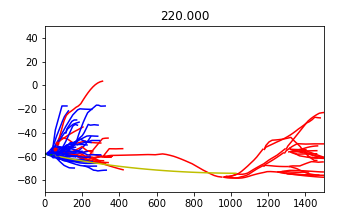
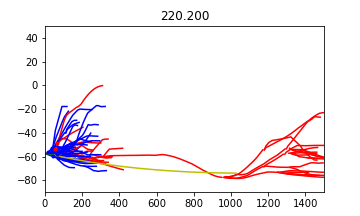
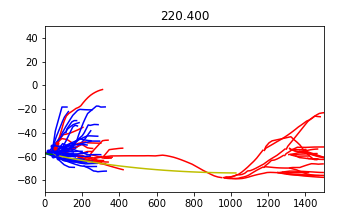
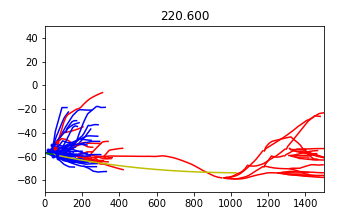
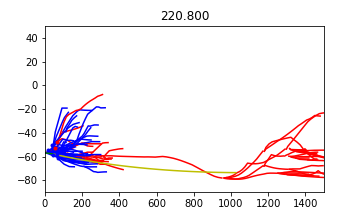
...
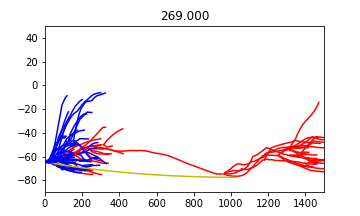
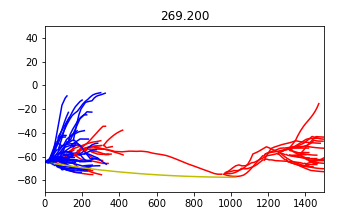
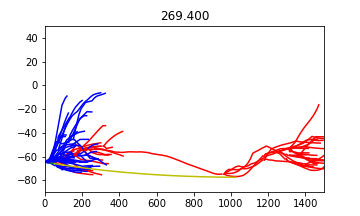
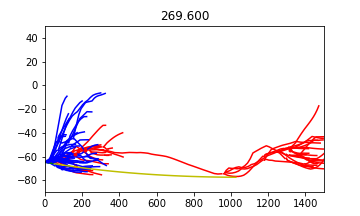
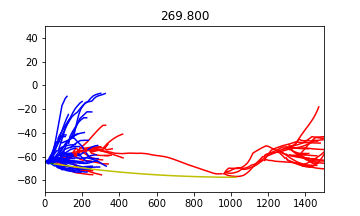

In [82]:
if not 'D3_stim_animation' in db.keys():
    cell = I.simrun_simtrail_to_cell_object(db, some_index)        
    I.cell_to_animation(cell, \
                        xlim = [0,1500], \
                        ylim = [-90, 50], \
                        tstart = 245-25, \
                        tend = 245+25, \
                        tstep = 0.2, \
                        outdir = db.create_managed_folder('D3_stim_animation'))
I.display_animation(db['D3_stim_animation'].join('*', '*png'), embedded = True)

In [91]:
import barrel_cortex
from importlib import reload
reload(barrel_cortex)

<module 'barrel_cortex' from '/gpfs/soma_fs/scratch/meulemeester/project_src/in_silico_framework/barrel_cortex/__init__.py'>


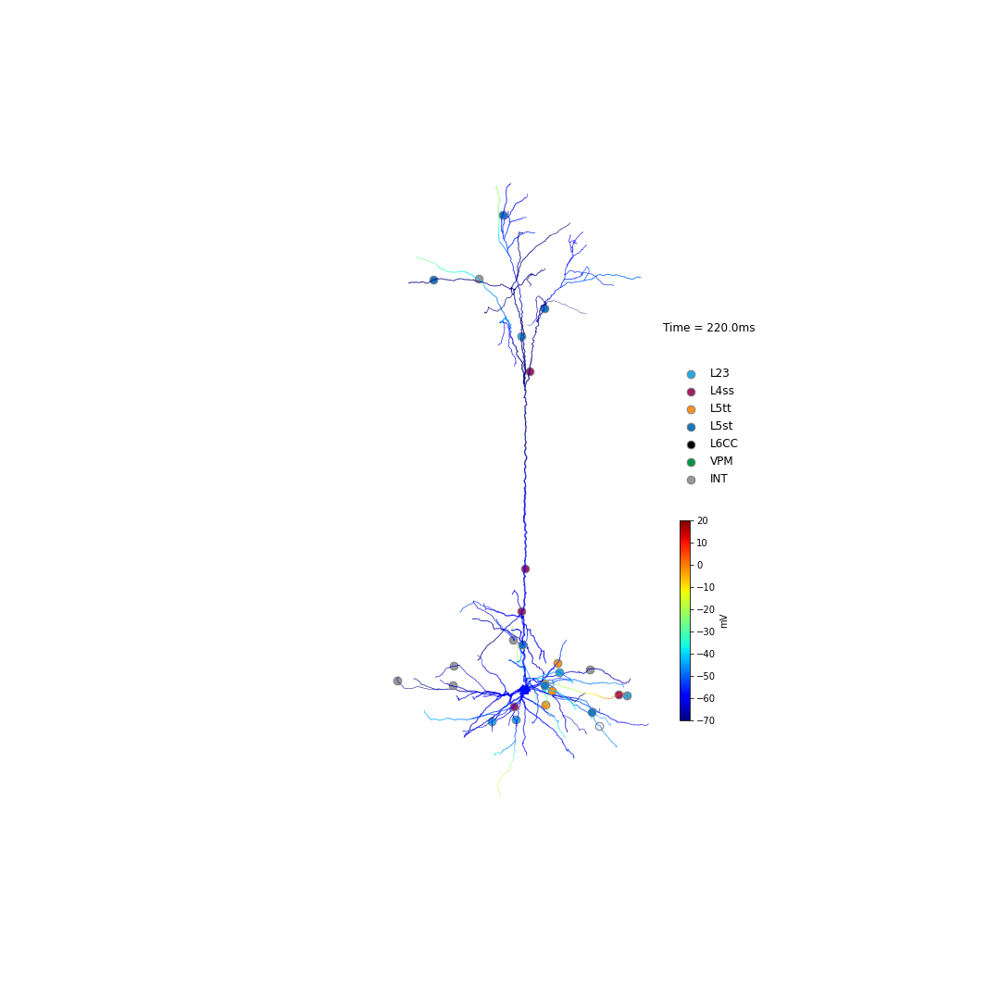
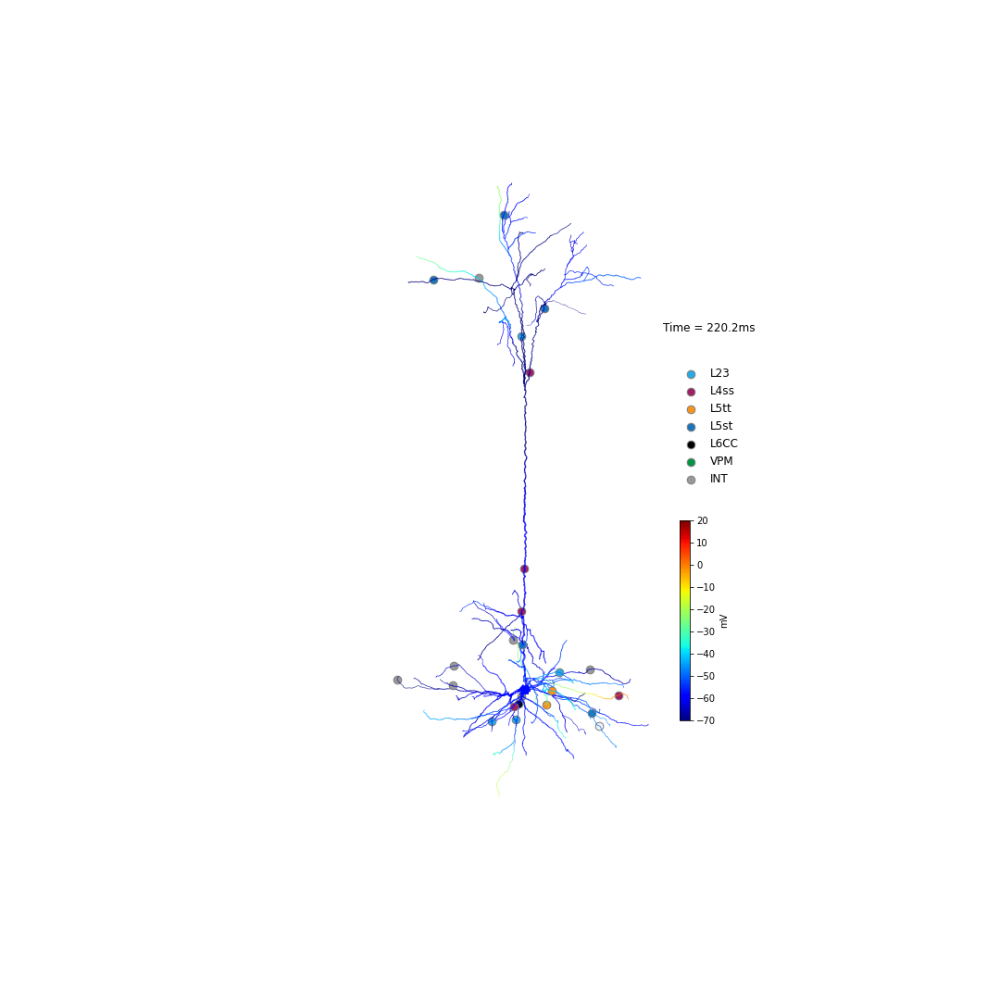
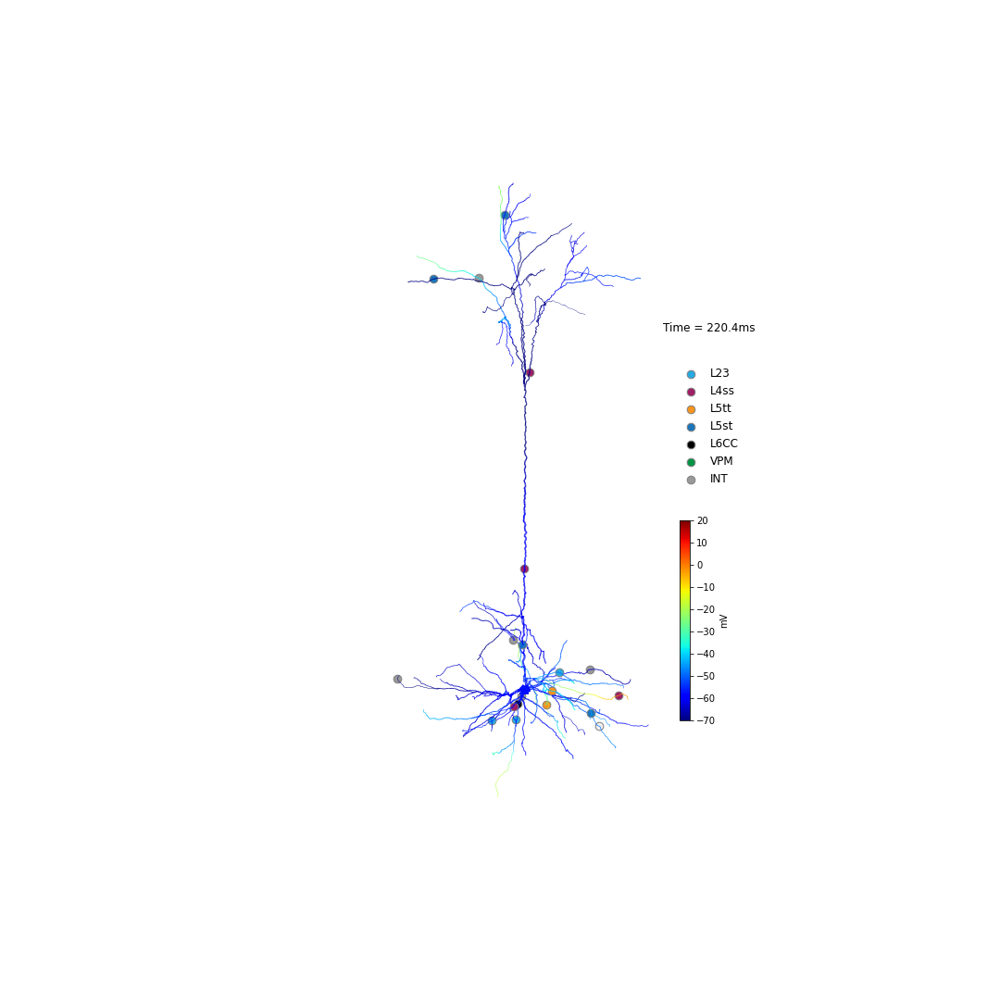
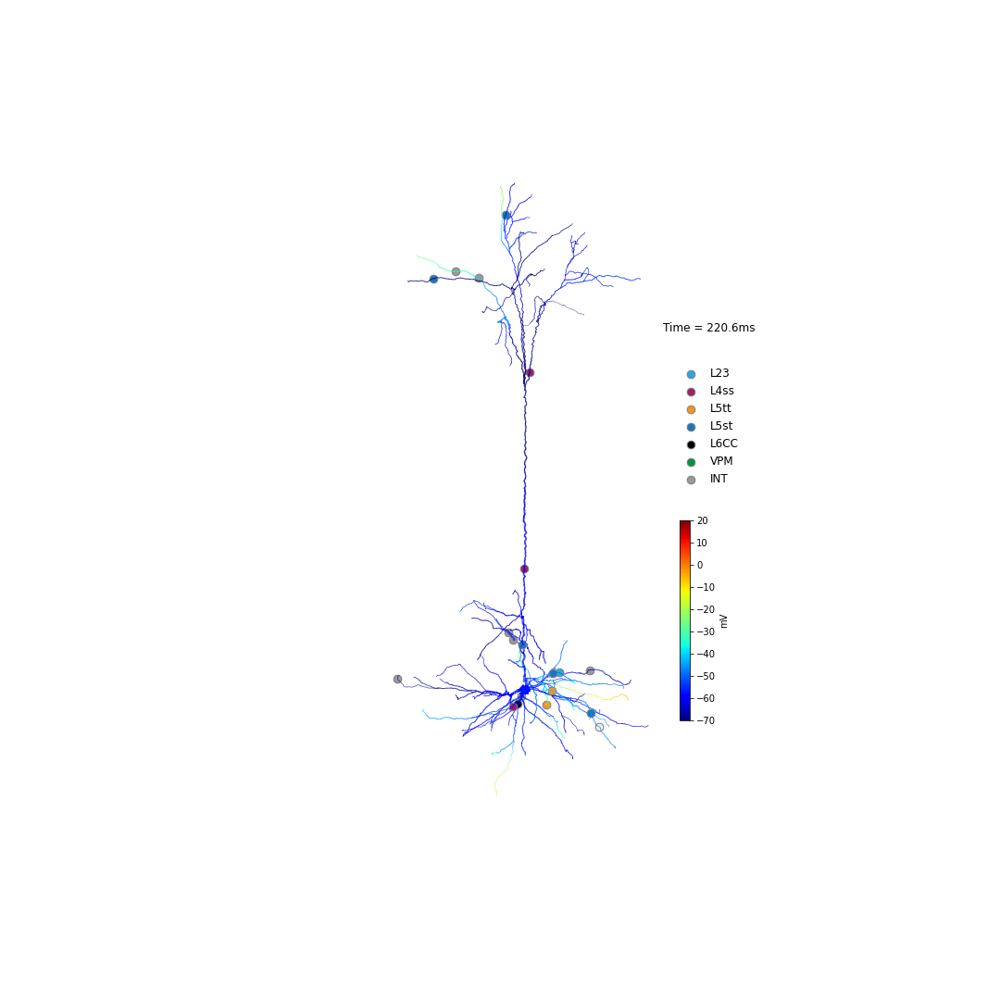
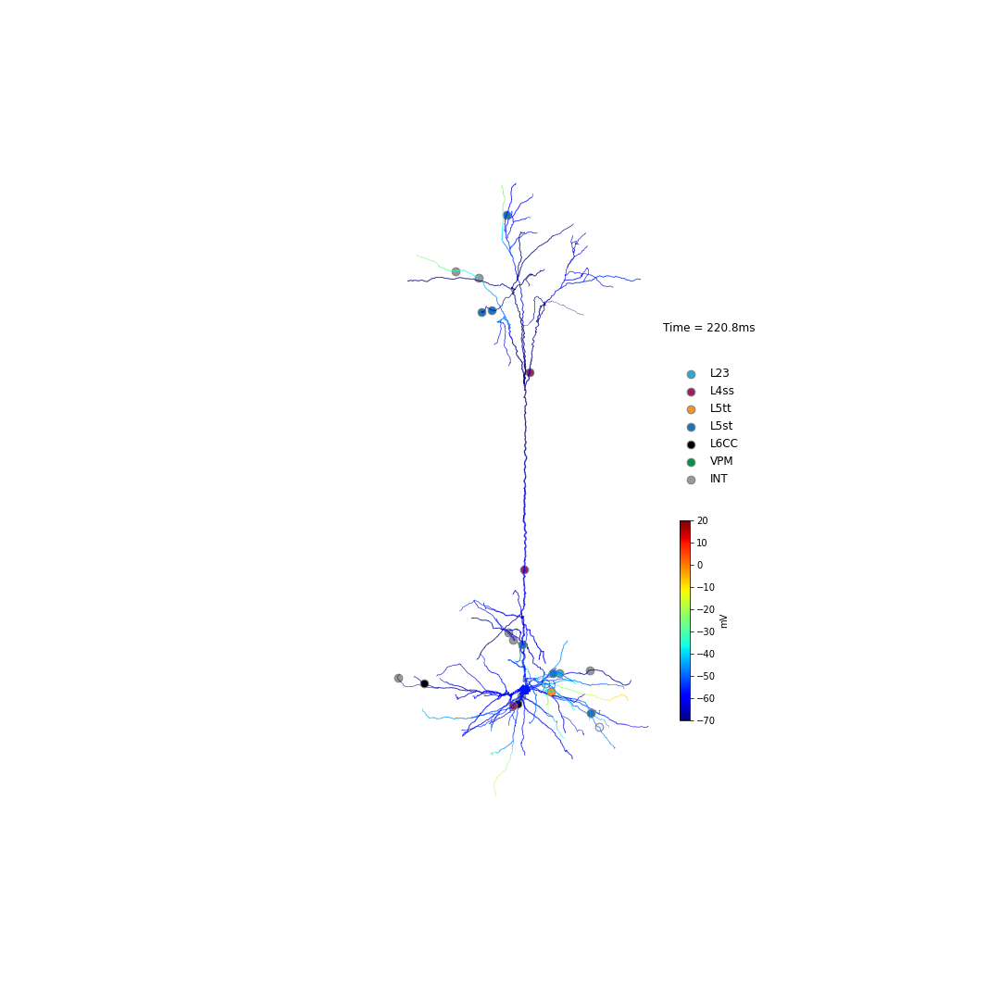
...
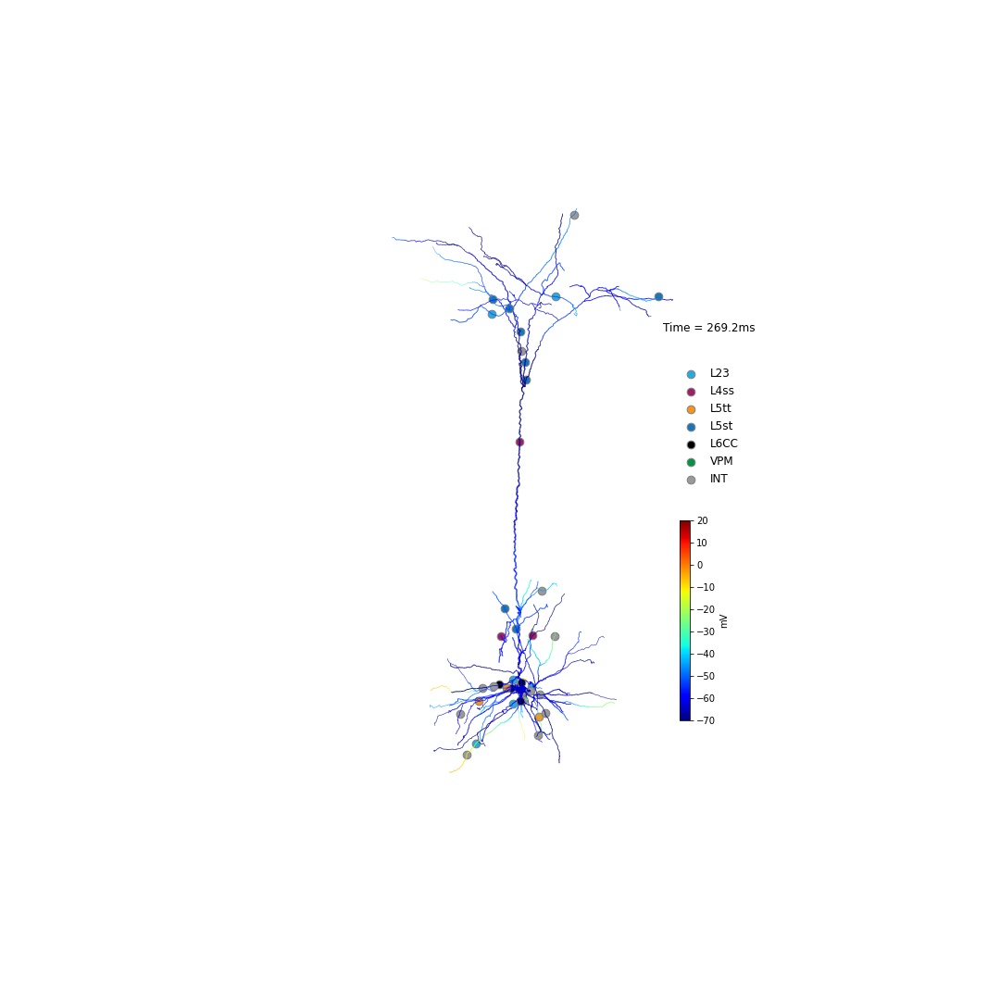
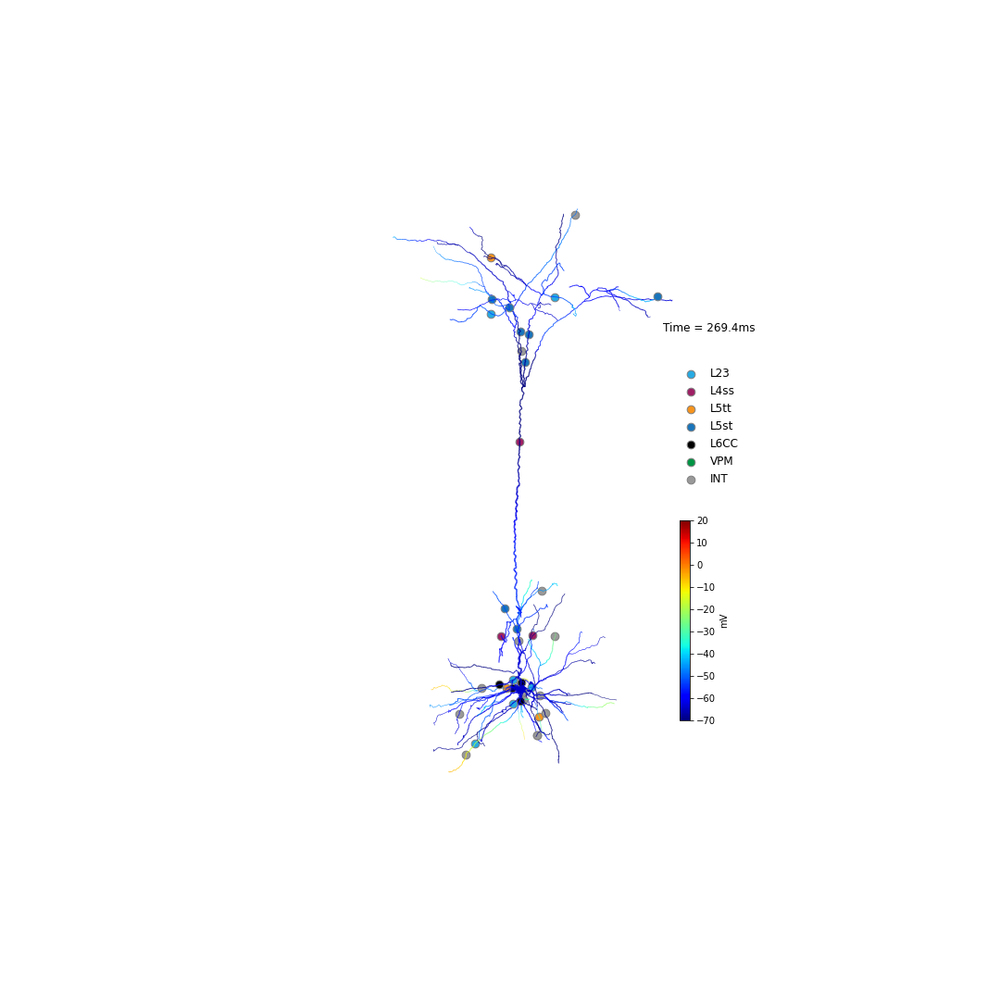
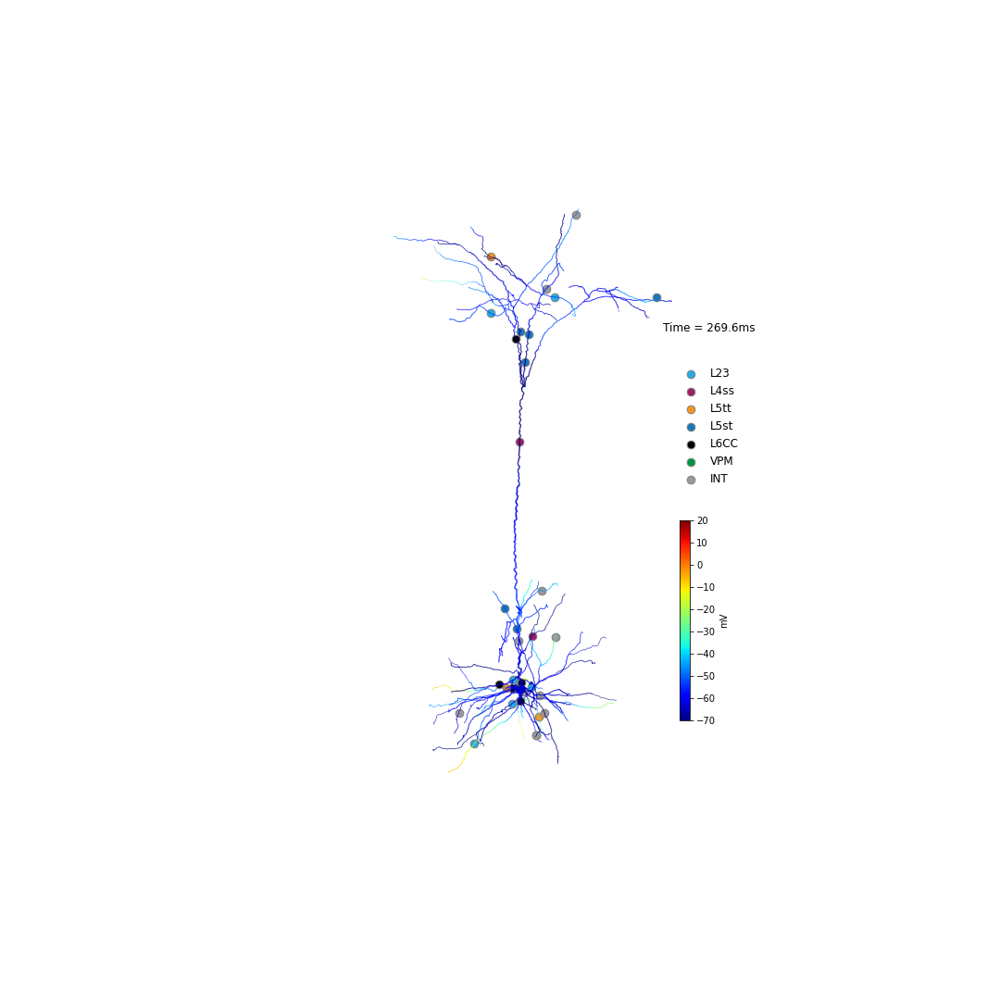
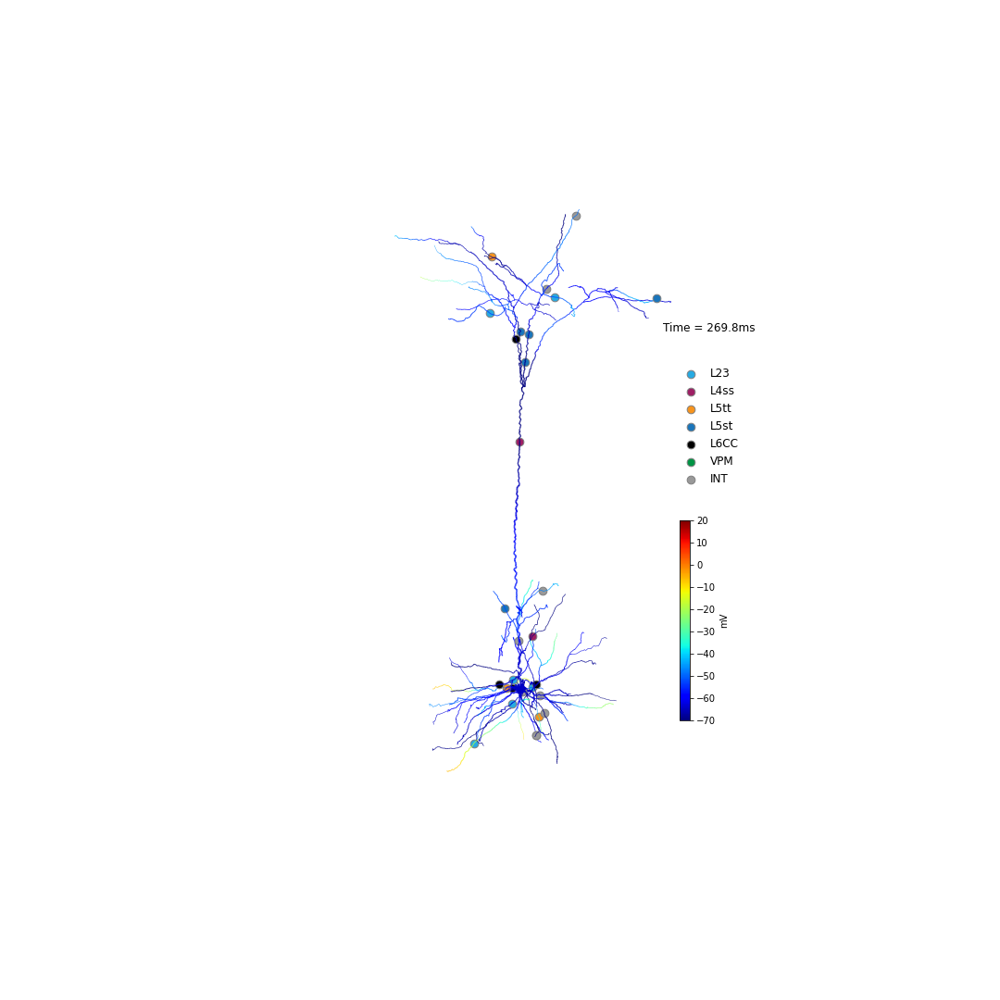
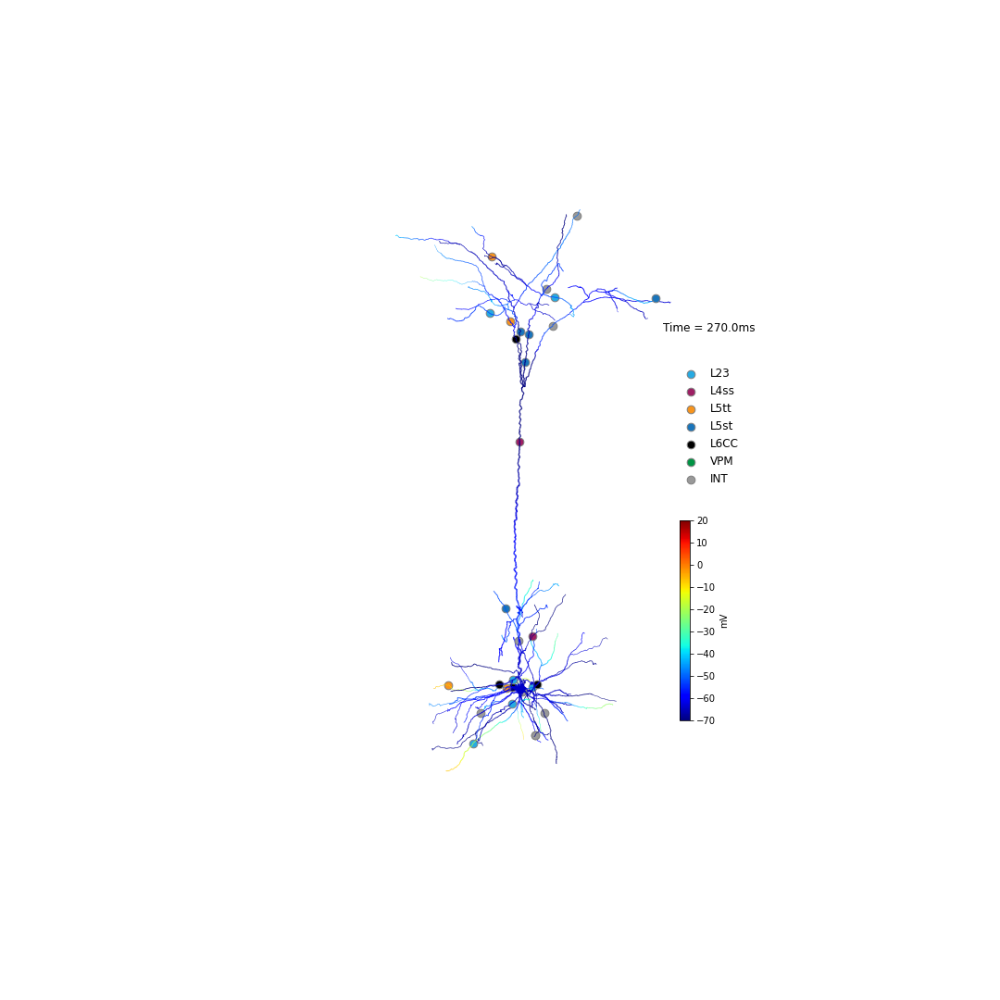

In [110]:
# # To remake the visualization, uncomment this code
# if os.path.exists(db.basedir/'D3_stim_animation_3d'):
#     I.shutil.rmtree(db.basedir/'D3_stim_animation_3d')

cmv.population_to_color_dict['inactive'] = "#f0f0f0"  # add color for inactive

cmv = I.CellMorphologyVisualizer(cell)
images_path = db.basedir/'D3_stim_animation_3d'
cmv.display_animation_voltage_synapses_in_morphology_3d(
    images_path=images_path.as_posix(), client=client, 
    t_start=245-25, t_end=245+25, t_step=0.2)